Homework 2
---

To be done in groups of 2 students.

Pricing Diamonds
---

The dataset contains the following features.
- price : price of the dimaond in dollars.

- carat : weight of the diamond

- cut : quality of the cut

- color : color of the diamond, J (worst) to D (best)

- clarity : I1 (worst), SI2, SI1, VS2, VS1, VVS2, VVS1, IF (best)

- x : length (mm) 

- y :  width (mm) 

- z : depth (mm) 

- depth : 2 * z / (x + y)

- table :  width of top of diamond relative to widest point



Your job
---
- Try to understand the data, visualize it. You may use unsupervised learning methods at this stage.
- The main aim is then to predict, using supervised learning methods, the price of diamonds based on their different quality features.

We want to see the following things
---
- Prediction results and mean squared error obtained on the test set for the methods you considered.
- A discussion about the impact of the hyperparameters of the methods on your predictions.
- A clear comparison between your solutions (a table, and/or plots comparing the results obtained with different methods).
- A discussion about the difficulties encountered if applicable.
- You'll get a good grade if you reach a good accuracy **and** if your notebook is clean, with clear graphs and explanations of what you did **and** if you did efficient calibration of the methods and serious comparisons between different methods
- You will send your notebook **containing** the results (**WE WON'T RUN YOUR NOTEBOOK**), namely with the graphs and results that you want to show, as a **unique** jupyter notebook file (`.ipynb` extension). We won't open any other supplementary file.

Hand in your assignment  before 09/11/20 23h55 :
---
- via Moodle for all Université de Paris students
- via email if Moodle not possible for Paris 1 students, subject [Machine Learning DM2], aurelie.fischer@univ-paris-diderot.fr


Example of methods
---
Unsupervised learning methods and visualization :
- PCA
- k-means
- mixture models
- spectral clustering
...

Supervised learning methods :
- discriminant analysis
- logistic regression
- SVM
- regression trees
- bagging
- random forests
- boosting
- ...

# Load and Preprocess

In [30]:
import pandas as pd
data = pd.read_csv('diamonds.csv')
data

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...,...
53935,53936,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,53937,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,53938,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,53939,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


## Inspecting types

In [31]:
data.dtypes

Unnamed: 0      int64
carat         float64
cut            object
color          object
clarity        object
depth         float64
table         float64
price           int64
x             float64
y             float64
z             float64
dtype: object

In [32]:
import numpy as np

# Numerical columns
print("Numerical columns : ", list(data.select_dtypes(np.number).columns))

# Looking for categorical columns
print("\nnumber of distinct values of non-numerical columns\n",
      data.select_dtypes(exclude = np.number).nunique())

Numerical columns :  ['Unnamed: 0', 'carat', 'depth', 'table', 'price', 'x', 'y', 'z']

number of distinct values of non-numerical columns
 cut        5
color      7
clarity    8
dtype: int64


In [33]:
# Checking if "table" column contains only integers contrary to description
all(x.is_integer() for x in data.table)

False

## Looking for outliers

In [34]:
# Quick summary statistics of the dataset numerical features'
data.describe(include=np.number)

,Unnamed: 0,carat,depth,table,price,x,y,z
count,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000
mean,26970.500000,0.797940,61.749405,57.457184,3932.799722,5.731157,5.734526,3.538734
std,15571.281097,0.474011,1.432621,2.234491,3989.439738,1.121761,1.142135,0.705699
min,1.000000,0.200000,43.000000,43.000000,326.000000,0.000000,0.000000,0.000000
25%,13485.750000,0.400000,61.000000,56.000000,950.000000,4.710000,4.720000,2.910000
50%,26970.500000,0.700000,61.800000,57.000000,2401.000000,5.700000,5.710000,3.530000
75%,40455.250000,1.040000,62.500000,59.000000,5324.250000,6.540000,6.540000,4.040000
max,53940.000000,5.010000,79.000000,95.000000,18823.000000,10.740000,58.900000,31.800000


In [35]:
# Displaying extreme values of x, y and z
data[(data[["x","y","z"]]==0).any(axis=1) | (data[["x","y","z"]]>20).any(axis=1)]

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
2207,2208,1.00,Premium,G,SI2,59.1,59.0,3142,6.55,6.48,0.00
2314,2315,1.01,Premium,H,I1,58.1,59.0,3167,6.66,6.60,0.00
4791,4792,1.10,Premium,G,SI2,63.0,59.0,3696,6.50,6.47,0.00
5471,5472,1.01,Premium,F,SI2,59.2,58.0,3837,6.50,6.47,0.00
10167,10168,1.50,Good,G,I1,64.0,61.0,4731,7.15,7.04,0.00
11182,11183,1.07,Ideal,F,SI2,61.6,56.0,4954,0.00,6.62,0.00
11963,11964,1.00,Very Good,H,VS2,63.3,53.0,5139,0.00,0.00,0.00
13601,13602,1.15,Ideal,G,VS2,59.2,56.0,5564,6.88,6.83,0.00
15951,15952,1.14,Fair,G,VS1,57.5,67.0,6381,0.00,0.00,0.00
24067,24068,2.00,Premium,H,SI2,58.9,57.0,12210,8.09,58.90,8.06


## Reloading data

In [36]:
diams_dtypes = {
    'carat': np.float,
    'depth': np.float,
    'table': np.float,
    'x': np.float,
    'y': np.float,
    'z': np.float,
    'cut': "category",
    'clarity': "category",
    'color': "category",
    'price':np.int
}

data = pd.read_csv('diamonds.csv', 
                   usecols=diams_dtypes.keys(),
                   dtype=diams_dtypes
                  )

#### Ordering the categorical columns

data['clarity']=pd.Categorical(data['clarity'], 
                        categories=["I1", "SI2", "SI1", "VS2", "VS1", "VVS2", "VVS1", "IF"],
                        ordered=True)

data['cut']=pd.Categorical(data['cut'], 
                        categories=["Fair", "Good", "Very Good", "Premium", "Ideal"],
                        ordered=True)

data['color']=pd.Categorical(data['color'], 
                        categories=["J", "I", "H", "G", "F", "E", "D"],
                        ordered=True)

#### Droping outliers
data = data[(data[["x","y","z"]]> 0).all(axis=1) & (data[["x","y","z"]]< 20).all(axis=1)]


data.dtypes

carat       float64
cut        category
color      category
clarity    category
depth       float64
table       float64
price         int64
x           float64
y           float64
z           float64
dtype: object

In [37]:
# Retrieving numerical columns
num_col = list(data.select_dtypes(np.number).columns)

# Retrieving categorical columns
cat_col = [col for col in data.columns if data[col].nunique() < 10]

## Quick sanity check and summary

In [38]:
# Checking for missing values
data.isnull().sum()

carat      0
cut        0
color      0
clarity    0
depth      0
table      0
price      0
x          0
y          0
z          0
dtype: int64

In [39]:
# Quick summary statistics of the dataset numerical features'
data.describe(include=np.number)

,carat,depth,table,price,x,y,z
count,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000
mean,0.797687,61.749565,57.456939,3930.910474,5.731605,5.733428,3.539409
std,0.473777,1.432318,2.234069,3987.215003,1.119402,1.111272,0.691620
min,0.200000,43.000000,43.000000,326.000000,3.730000,3.680000,1.070000
25%,0.400000,61.000000,56.000000,949.000000,4.710000,4.720000,2.910000
50%,0.700000,61.800000,57.000000,2401.000000,5.700000,5.710000,3.530000
75%,1.040000,62.500000,59.000000,5323.000000,6.540000,6.540000,4.040000
max,5.010000,79.000000,95.000000,18823.000000,10.740000,10.540000,6.980000


# Visualizing data

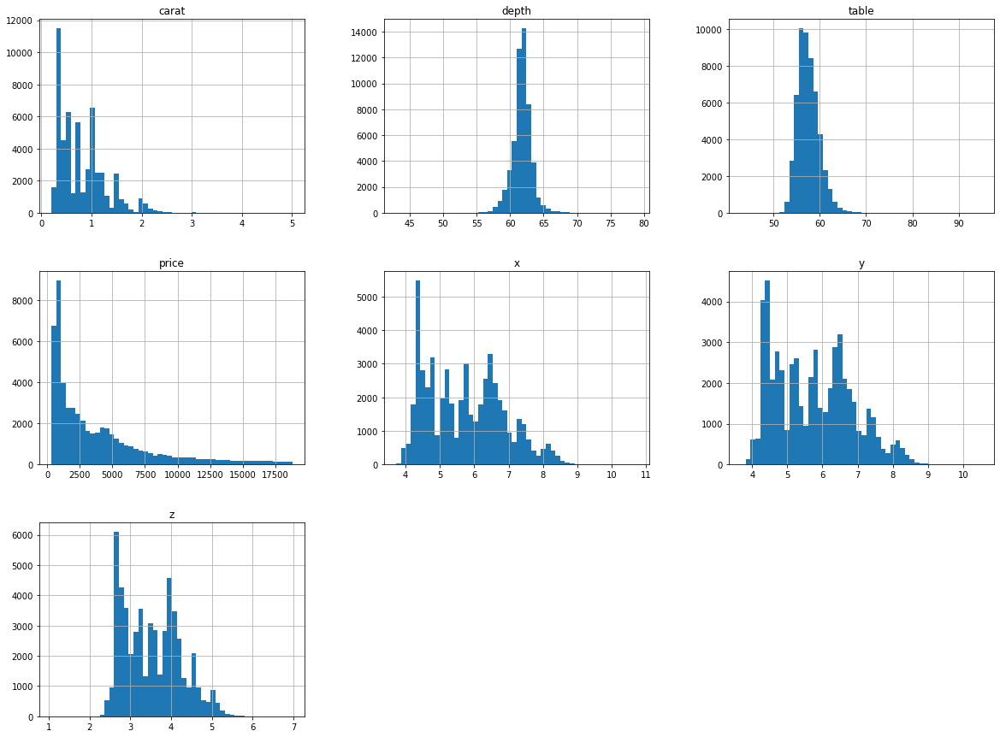

In [43]:
import matplotlib.pyplot as plt
import seaborn as sns

data.hist(bins=50,figsize=(20,15))
plt.show()

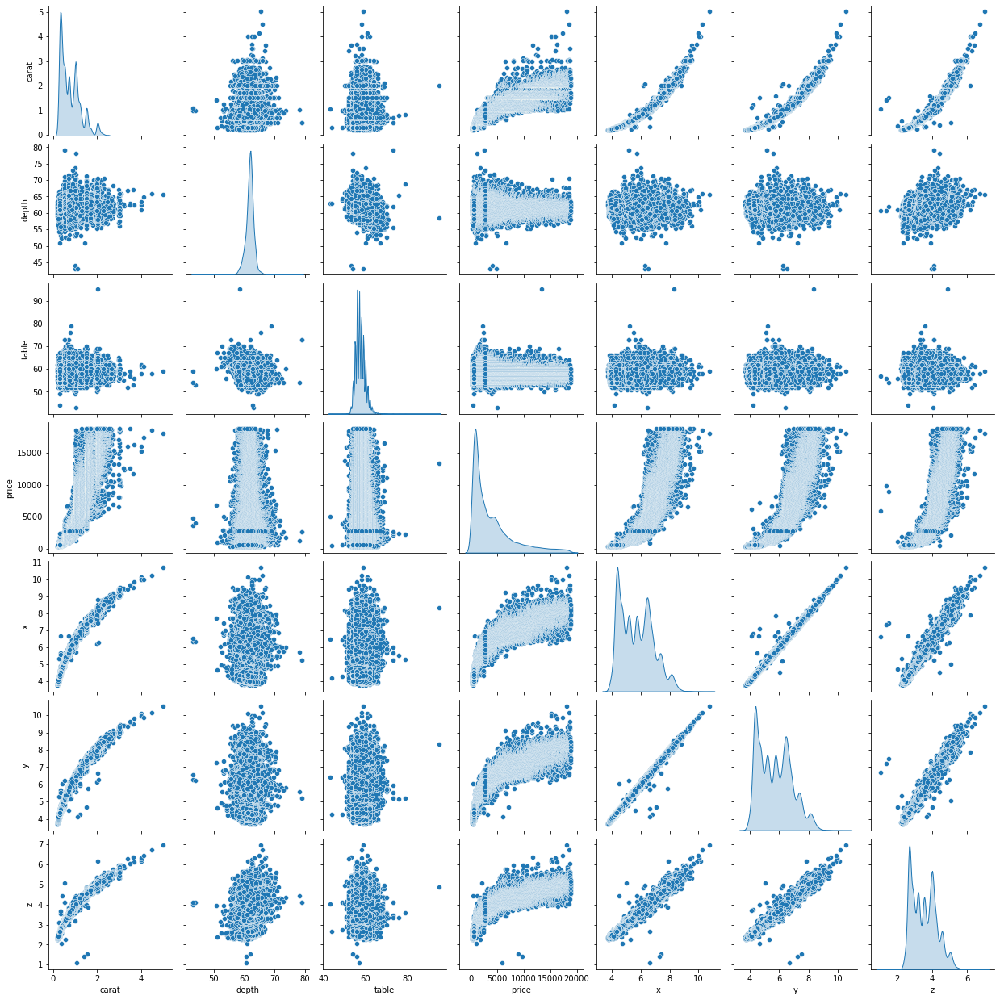

In [44]:
sns.pairplot(data , diag_kind = 'kde');

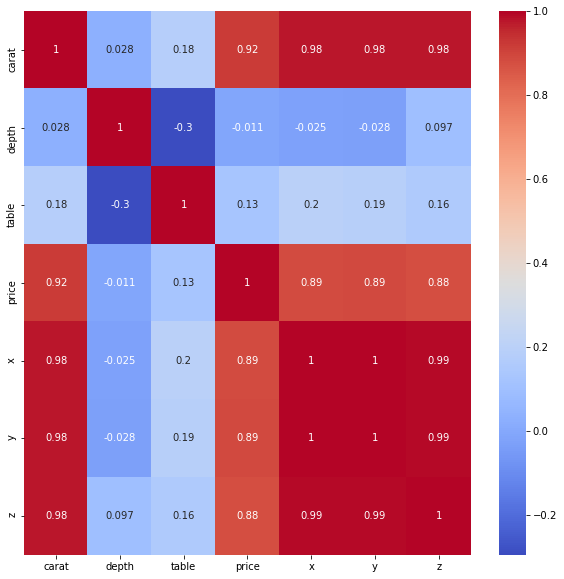

In [45]:
plt.figure(figsize = (10,10))
sns.heatmap(data.corr(),annot = True , cmap = 'coolwarm' );

## Distribution of some numerical features

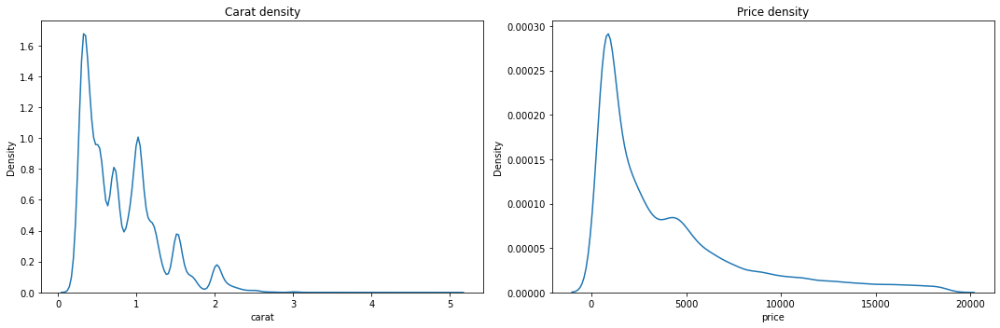

In [46]:
fig, axes = plt.subplots(1,2, figsize=(15,5))

axes[0].set_title('Carat density')
sns.kdeplot(data.carat,
            ax=axes[0]
           )

axes[1].set_title('Price density')
sns.kdeplot(data.price,
            ax=axes[1],
            )

plt.tight_layout()

## Distributions of some categorical features

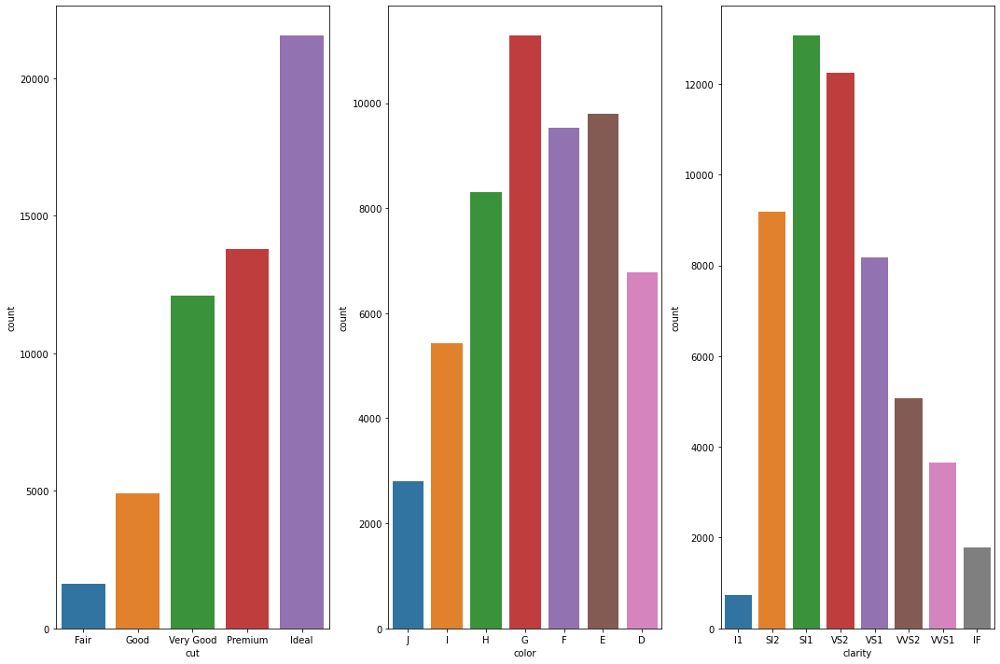

In [47]:
fig, axes = plt.subplots(1,3, figsize=(15,10))

for axi, col in zip(axes.flatten(), cat_col) :
    sns.countplot(x=data[col], 
                  ax = axi
                 )

plt.tight_layout()

## Numerical columns by categorical columns

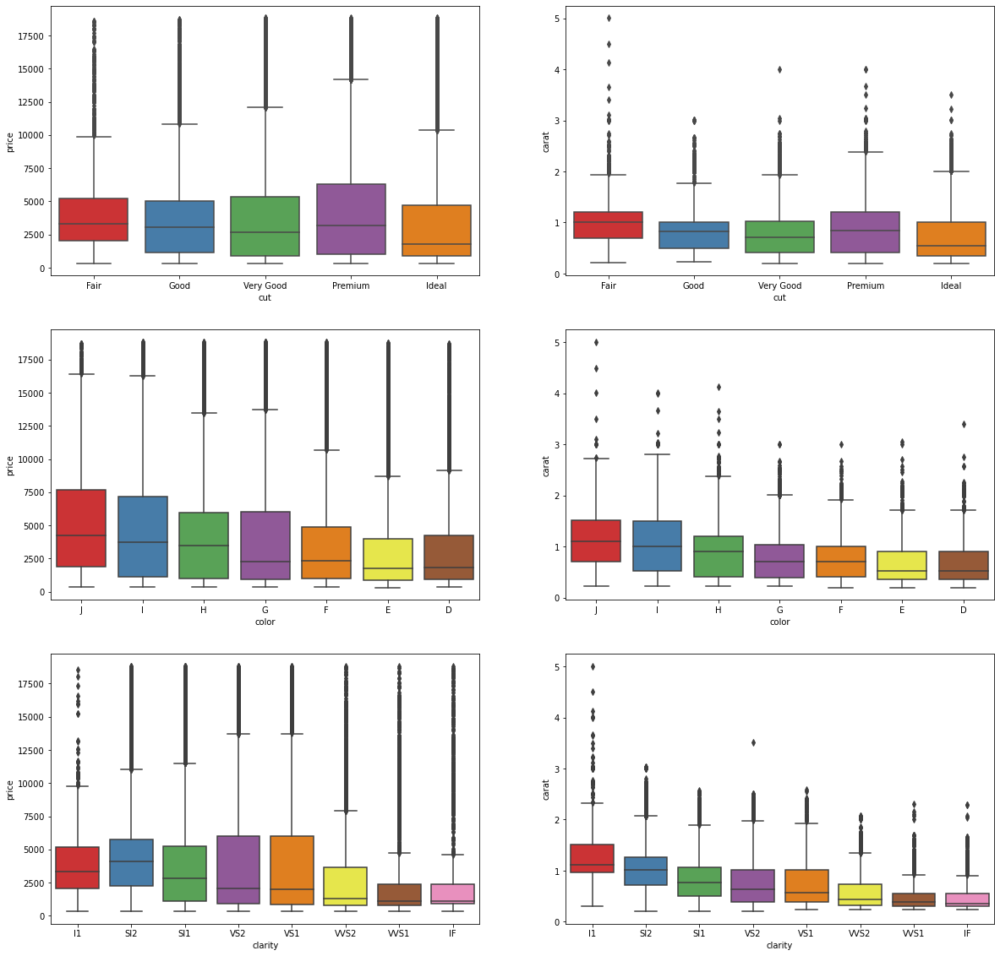

In [48]:
fig, axes = plt.subplots( len(cat_col),2,figsize=(20,20))

for j, num in enumerate(['price', 'carat']):    
    for i, cat in enumerate(cat_col):
                sns.boxplot(x=cat,
                            y=num,
                            data=data,                          
                            palette="Set1", 
                            ax=axes[i, j])

# Deeper visualizations

## PCA

In [49]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from math import log

# applying log to data
logdata_pca = data[num_col].applymap(log)

## Scale data
scaler = StandardScaler()
scaler.fit(logdata_pca)
sc_log_data=scaler.transform(logdata_pca)

pca = PCA(n_components=len(num_col))
pca.fit(sc_log_data)

PCA(n_components=7)

### Scree Plot

In [50]:
import plotly.express as px

print("\nVariance explained by the first three PCs:",
     sum(pca.explained_variance_ratio_[:3]))


px.bar(x= range(0,len(num_col)),
       y=pca.explained_variance_ratio_,
       title = "Explained Variances of Principal Axis",
       labels={"x" : "Principal Component", "y" : "Explained Variances"}
      )


Variance explained by the first three PCs: 0.9919713779794957


### Correlation circles

In [51]:
X = pca.transform(sc_log_data)[:,:3]

#### Computing correlations between variables and PCs
corr_matrix = np.zeros( (sc_log_data.shape[1], X.shape[1]) )

for i,zi in enumerate(sc_log_data.T):
    for j, xj in enumerate(X.T):
        corr_matrix[i,j] =np.corrcoef(zi,xj)[0,1]

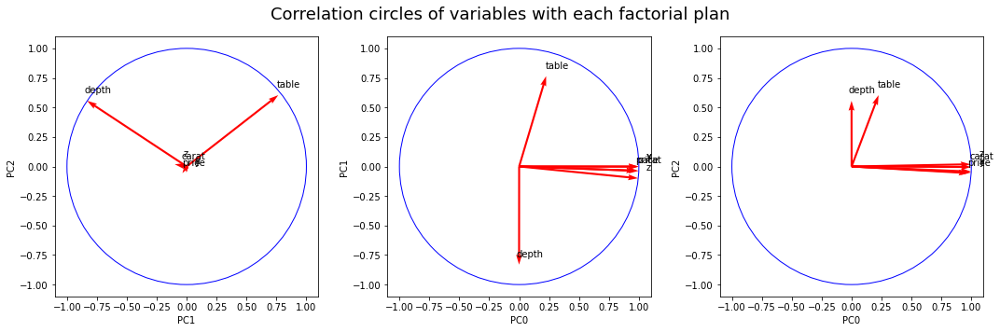

In [52]:
from itertools import product

### function to produce iteration indexes
def iter_pairs(indexes):
    def comp(x):
        return x[0] < x[1]
    return filter(comp, product(indexes, indexes))

fig, axes = plt.subplots(1,3, figsize=(15,5), )

for i,j in iter_pairs(range(corr_matrix.shape[1])):
    
    axes[(i+j)%3].quiver(np.zeros(corr_matrix.shape[0]), np.zeros(corr_matrix.shape[0]),
               corr_matrix[:,i], corr_matrix[:,j], 
               angles='xy', scale_units='xy', scale=1,
                color='r')

    # Add labels based on feature names (here just numbers)
    feature_names = num_col
    for a,b,c in zip(corr_matrix[:,i]+0.09, corr_matrix[:,j]+0.09, num_col):
        axes[(i+j)%3].text(a, b, c, ha='center', va='center')

    # Add unit circle
    circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
    axes[(i+j)%3].add_patch( circle)


    # # Label axes
    axes[(i+j)%3].set(xlabel=f"PC{i}",ylabel=f"PC{j}")

# Done
fig = plt.gcf()
fig.suptitle("Correlation circles of variables with each factorial plan", fontsize=18)
fig.tight_layout()

The Correlation circles suggest that $PC0$ is strongly (and positively) correlated with $(x,y,z)$, carat and price variables, and very poorly correlated with depth (orthogonal) and table. Keeping in mind that price is the variable we want to predict aftewards we could drop depth and table columns since they don't contain much information.

### Data projection

In [53]:
X= pca.transform(sc_log_data)[:,:3]
px.scatter_3d(x=X[:,0], y=X[:,1], z=X[:,2], 
              title="Data projection",
              labels={"x": "PC0", 
                      "y": "PC1", 
                      "z": "PC2",
                      "color":"Price"},
              color=data["price"]
             )

In [54]:
px.scatter(x=X[:,0], y=X[:,1], 
           color=data["price"],
            title="Data projection",
            labels={"x": "PC0", 
                    "y": "PC1", 
                    "z": "PC2",
                    "color":"Price"}
          )

We can see clearly here that the projection on $PC0$ reflects the variety of prices.

## Kmeans

In [57]:
from sklearn.cluster import KMeans

def fit_algos(X, algos):
    '''
    Inputs:
        X: np array, data to fit algo on
        algos: list of algos
    Output:
        None. The algos will be fit
    '''
    for algo in algos:
        algo.fit(X)
        
        
def normalize_feats(df, feats, norm='l2'):
    '''
    Inputs:
        df: pandas dataframe
        feats: list of str #column names
    Output:
        X: 2D np array of df[feats] normalized to given norm
    '''
    XX = np.array(df.loc[:, feats])
    X_1 = (XX - XX.min(axis=0)) / (XX.max(axis=0) - XX.min(axis=0))
    return X_1

data.reset_index(inplace=True, drop=True)
X = normalize_feats(data, data.select_dtypes(include=[np.number]).columns)
nb_clusters = [i for i in range(2, 8)]
k_KMeans = [KMeans(n_clusters=i) for i in nb_clusters]
fit_algos(X, k_KMeans)
print('kmeans fit done')
X

kmeans fit done


array([[0.00623701, 0.51388889, 0.23076923, ..., 0.03138374, 0.04373178,
        0.23011844],
       [0.002079  , 0.46666667, 0.34615385, ..., 0.02282454, 0.02332362,
        0.20981387],
       [0.00623701, 0.38611111, 0.42307692, ..., 0.04564907, 0.05685131,
        0.20981387],
       ...,
       [0.1039501 , 0.55      , 0.32692308, ..., 0.27532097, 0.29154519,
        0.4213198 ],
       [0.13721414, 0.5       , 0.28846154, ..., 0.34522111, 0.35568513,
        0.45177665],
       [0.11434511, 0.53333333, 0.23076923, ..., 0.29957204, 0.31924198,
        0.43485618]])

Comparing runs: 0 and 1


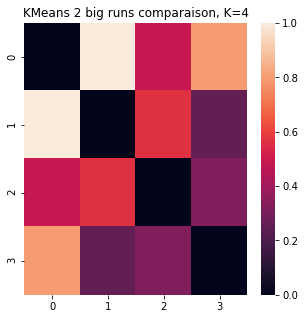

Comparing runs: 0 and 2


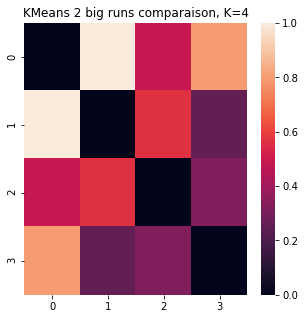

Comparing runs: 0 and 3


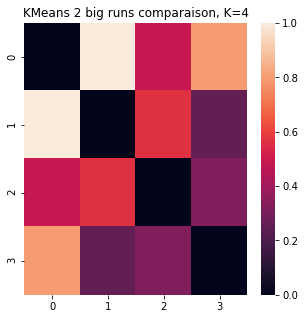

Comparing runs: 0 and 4


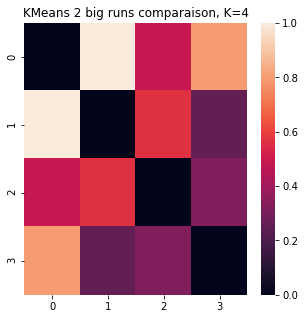

Comparing runs: 0 and 5


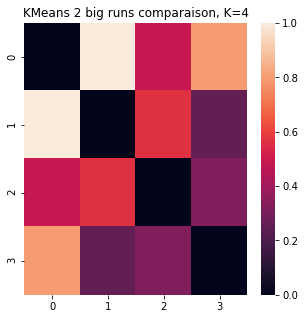

Comparing runs: 1 and 2


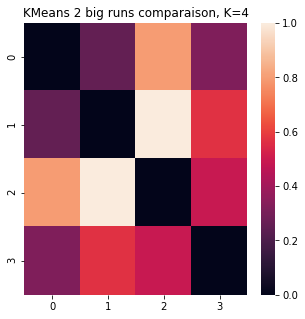

Comparing runs: 1 and 3


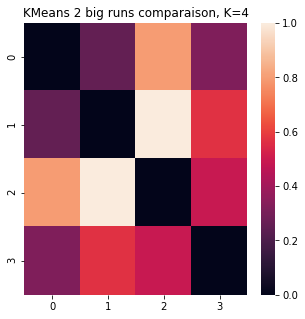

Comparing runs: 1 and 4


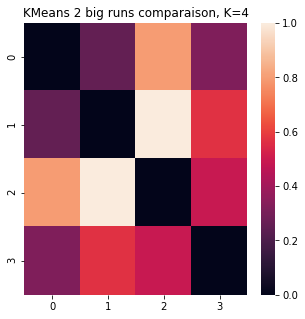

Comparing runs: 1 and 5


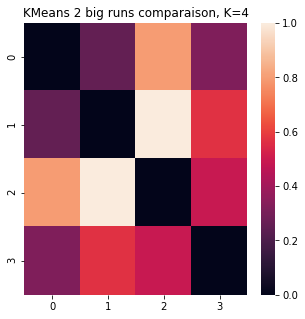

Comparing runs: 2 and 3


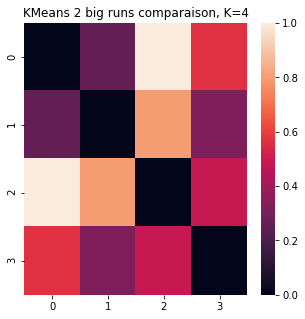

Comparing runs: 2 and 4


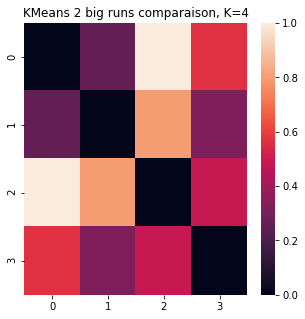

Comparing runs: 2 and 5


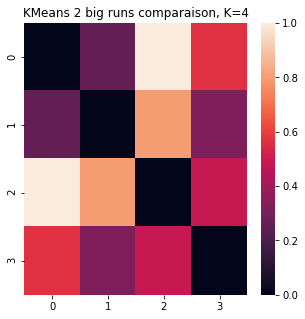

Comparing runs: 3 and 4


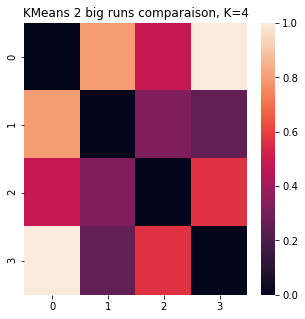

Comparing runs: 3 and 5


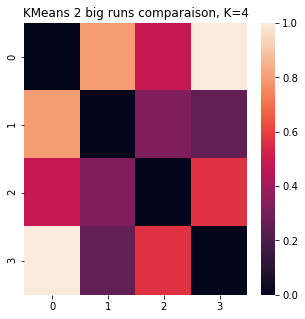

Comparing runs: 4 and 5


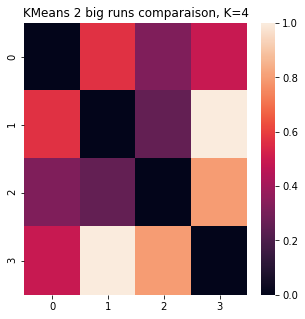

In [58]:
from sklearn.metrics.pairwise import euclidean_distances, cosine_distances
from scipy.optimize import linear_sum_assignment
big_runs = 6
big_run_results = []
K = 4
for one_run in range(big_runs):
    n_runs = 50

    K1Means = [KMeans(n_clusters=K, init='random') for i in range(n_runs)]
    K1Means[0].fit(X)
    centers0 = K1Means[0].cluster_centers_
    for idx, algo in enumerate(K1Means[1:]):
        algo.fit(X)
        centers1 = algo.cluster_centers_
        dC = euclidean_distances(centers0, centers1)
        row_i, col_i = linear_sum_assignment(dC)
        D = {}
        for i in row_i:
            D[col_i[i]] = [i]
            
        new_centers = np.zeros(shape=centers1.shape)
        for i in range(K):
            new_centers[D[i]] = centers1[i]

        centers0 = (centers0*(idx+1)+new_centers) / (idx+2)
    big_run_results += [centers0]

for idx1, run1 in enumerate(big_run_results):
    for idx2, run2 in enumerate(big_run_results):
        if idx2 > idx1:
            print('Comparing runs: {} and {}'.format(idx1, idx2))
            dC = euclidean_distances(run1, run2)
            
            row_i, col_i = linear_sum_assignment(dC)
            D = {}
            for i in row_i:
                D[col_i[i]] = [i]


            new_run2 = np.zeros(shape=run2.shape)
            for i in range(K):
                new_run2[D[i]] = run2[i]

            dC = euclidean_distances(run1, new_run2)
            plt.figure(figsize=(5,5))
            plt.title('KMeans 2 big runs comparaison, K='+str(K))
            ax = sns.heatmap(dC, linewidth=0, vmin=0, vmax=1)
            plt.show()



[[1 1 1 ... 3 3 3]
 [1 1 1 ... 0 0 0]
 [0 0 0 ... 1 1 1]
 [3 3 3 ... 1 1 1]
 [1 1 1 ... 2 2 2]
 [0 0 0 ... 1 1 1]]


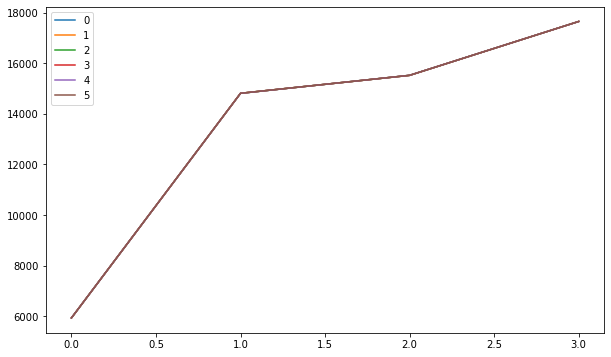

In [59]:
def my_fit(X, centers):
    '''
    Inputs:
        X: data, 2D numpy
        centers: list of np array
    description:
        returns labels of X according to the closest centroid.
    '''
    labels = []
    for i in range(X.shape[0]):
        x = X[i,:]
        Min = float('inf')
        label = -1
        for idx, center in enumerate(centers):
            d = np.linalg.norm(x-center) 
            if d < Min:
                Min = d
                label = idx
        labels.append(label)
    return labels

big_run_labels = []
for center in big_run_results:
    big_run_labels += [my_fit(X, center)]

big_run_labels = np.array(big_run_labels)
print(big_run_labels)

plt.figure(figsize=(10,6))
for idx, labels in enumerate(big_run_labels):
    XX, yy = np.unique(labels, return_counts=True)
    plt.plot(XX, sorted(yy), label=idx)
plt.legend()
plt.show()

#en absice le numero de cluster, en ordonnée le nombre de valeurs dans ce cluster pour chaque run

In [60]:
# Choosing the closest to means of all centroids

means_big_runs = big_run_results[0]
for one_big_run in big_run_results[1:]:

        dC = euclidean_distances(means_big_runs, one_big_run)

        row_i, col_i = linear_sum_assignment(dC)
        D = {}
        for i in row_i:
            D[col_i[i]] = [i]

        new_centers = np.zeros(shape=one_big_run.shape)
        for i in range(K):
            new_centers[D[i]] = one_big_run[i]

        means_big_runs = (means_big_runs*(idx+1)+new_centers) / (idx+2)
        
costs = []
for one_big_run in big_run_results:

        dC = euclidean_distances(means_big_runs, one_big_run)

        row_i, col_i = linear_sum_assignment(dC)
        
        cost = dC[row_i, col_i].sum()
        costs.append(cost)

voted = costs.index(min(costs))
voted_centers = big_run_results[voted]
voted_labels = big_run_labels[voted]
voted, costs

(1,
 [0.00012215720064373496,
  0.0001056514731220863,
  0.00014316139819597404,
  0.0001219231949187241,
  0.00010951039843708338,
  0.00025317130489756635])

[    0     1     2 ... 53614 53615 53616]


<ipython-input-63-967f0ec3cf40>:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

No handles with labels found to put in legend.


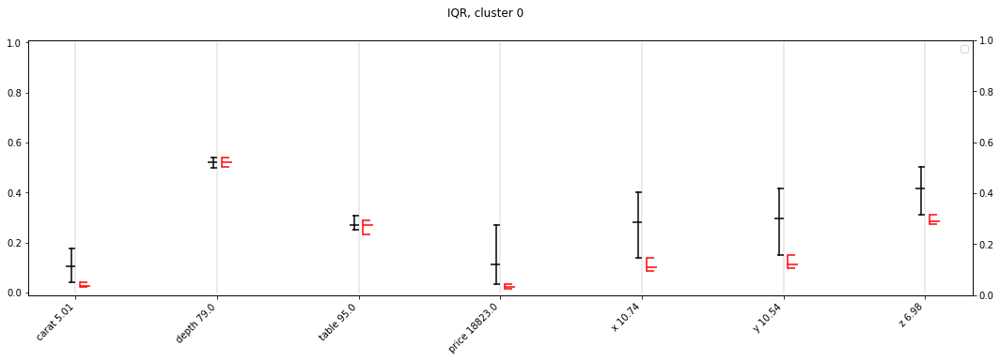

<ipython-input-63-967f0ec3cf40>:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

No handles with labels found to put in legend.


[   90    92    93 ... 53914 53915 53916]


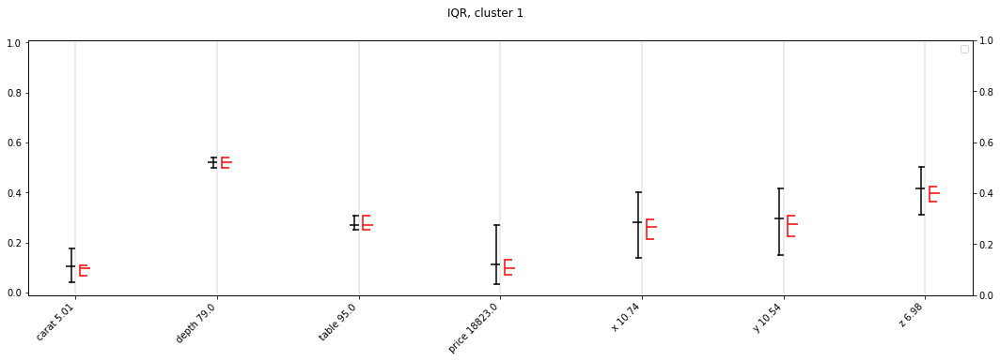

<ipython-input-63-967f0ec3cf40>:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

No handles with labels found to put in legend.


[   91   172   215 ... 53852 53856 53874]


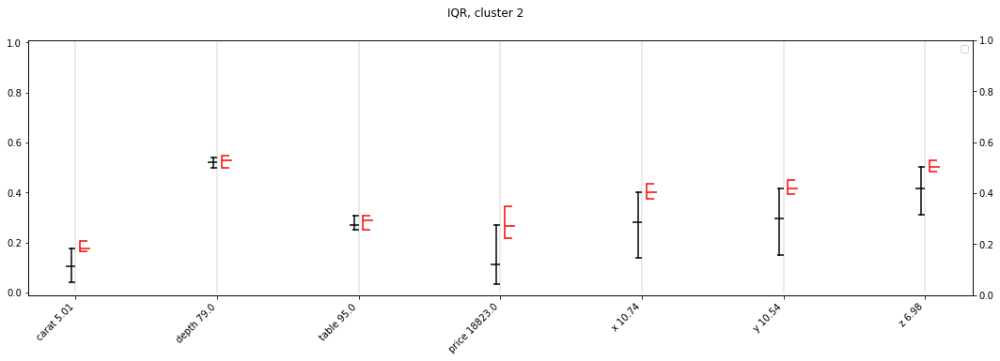

<ipython-input-63-967f0ec3cf40>:32: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[13749 13984 14130 ... 27729 27730 27731]


No handles with labels found to put in legend.


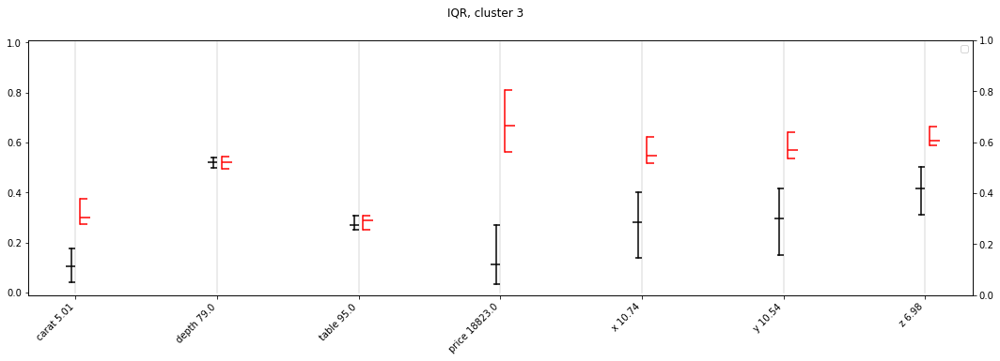

In [63]:
from sklearn.preprocessing import MinMaxScaler
def cluster_summary(df, columns, labels, cluster, Qs=[0.25,0.5,0.75], show_all=True, ax1=None, color='r', flip=False, gap=0.03, scaler=None):
    """
    Inputs:
        df: pandas dataframe
        columns: list of str # features from df
        labels: list of int # labels from clustering
        cluster:int # cluster to show
        Qs: list of floats #quartile to pot
        show_all: bool # show IQR of all points, for benchmark
        color: str # color usable by pyplot
        flip: bool # flip direction of quantile bars ( respect rule:  flip=True <=> gap<0 )
        gap: float # shift for quantile plot not to overlap ( respect rule:  flip=True <=> gap<0 )
        scaler: sklearn pre-fit scaler
    """
    df_radar = df[columns]
    ### ATTENTION A L'ORDRE
    # Scaling
    x = df_radar[columns].values #returns a numpy array 
    if scaler == None:
        scaler = MinMaxScaler()
        scaler.fit(x)
    x_scaled = scaler.transform(x)
    df_radar = pd.DataFrame(x_scaled, columns=columns)

    # saving max of features
    max_columns = scaler.data_max_
    print(np.where(labels==cluster)[0])
    # Filtering
    idx = np.where(labels==cluster)[0]
    df_cluster = df_radar.iloc[idx,:]
    df_cluster["labels"] = cluster

    # Calculating quantiles
    l_Qs = []
    for Q in Qs:
        l_Qs += [df_cluster.groupby('labels', sort=False).quantile(q=Q)]
        if Q==0.5:
            df_05 = l_Qs[-1]
            df_05['labels'] = df_05.index


    if show_all:
        df_radar["labels"] = -1
        l_Qs_all = []
        for Q in Qs:
            l_Qs_all += [df_radar.groupby('labels', sort=False).quantile(q=Q)]
            if Q==0.5:
                df_05_all = l_Qs_all[-1]
                df_05_all['labels'] = df_05_all.index

    plot = False
    if ax1 is None:
        plot = True
        fig, ax1 = plt.subplots(figsize=(18,5))
    ax1.set_ylim(ymin=-0.005, ymax=1.005)
    cols =columns

    x_locs = [i+gap for i in range(len(cols))]
    
    marker_side = 1
    if flip:
        marker_side = 0
    for q, df_q in zip(Qs, l_Qs):
        if q == 0.5:
            ax1.scatter(x_locs, df_q[cols], marker=marker_side, color=color, s=120, alpha=1)
        elif q in [0.25,0.75]:
            ax1.scatter(x_locs, df_q[cols], marker=marker_side, color=color, s=60, alpha=1)
        else:
            ax1.scatter(x_locs, df_q[cols], marker=marker_side, color=color, s=25, alpha=1)

    locs = ax1.get_xticks()
    labels = ax1.get_xticklabels()
        

    for idx, col in enumerate(cols):
        X = [idx +gap,idx+gap]
        Y = [l_Qs[0][col].values, l_Qs[-1][col].values]
        ax1.plot(X, Y, color=color, alpha=1, label='cluster')
        ax1.plot([idx,idx], [0,1], color='k', alpha=0.1)
        ax1.set_ylim(ymin=-0.01, ymax=1.01)

    ax1.set_xticks([i for i in range(len(cols))])
    cols_max = [col+' '+str(round(Max,2)) for col, Max in zip(cols, max_columns)]
    ax1.set_xticklabels(cols_max, ha='right', rotation=45)
    
    if show_all:
        for q, df_q in zip(Qs, l_Qs_all):
            if q == 0.5:
                ax1.scatter(cols, df_q[cols], marker=0, color='k', s=100, alpha=1)
            else:
                ax1.scatter(cols, df_q[cols], marker=0, color='k', s=50, alpha=1)

        for idx, col in enumerate(cols):
            X = [idx-gap, idx-gap]
            Y = [l_Qs_all[0][col].values, l_Qs_all[-1][col].values]
            ax1.plot(X, Y, color='k', alpha=1, label='all')
#     ax1.tick_params(labelright=True)
    ax2 = ax1.twinx()
    ax2.set_yticks([0.2*i for i in range(6)])
    if plot:
        plt.suptitle("IQR, cluster "+str(cluster))
        plt.legend()
        plt.show()
        
for i in range(K):
    cluster_summary(data, data.select_dtypes(include=[np.number]).columns, labels, i, show_all=True)

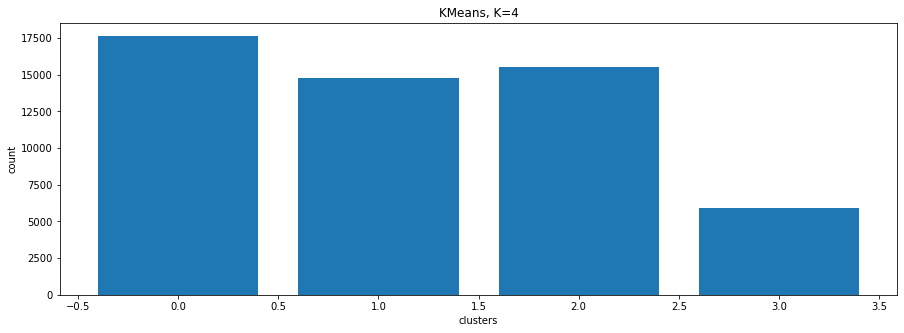

<ipython-input-67-a4da007dd877>:23: RuntimeWarning:

invalid value encountered in true_divide



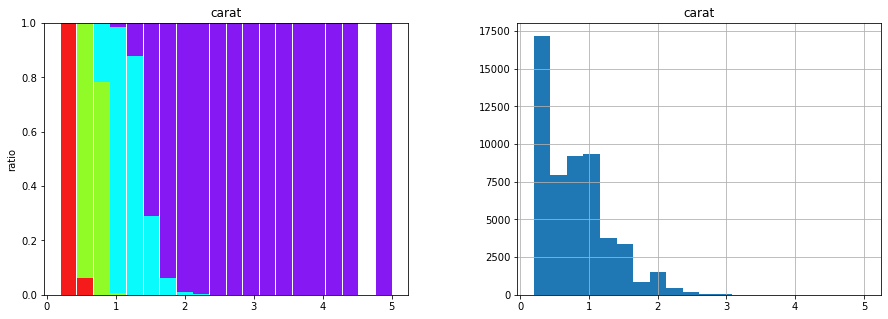

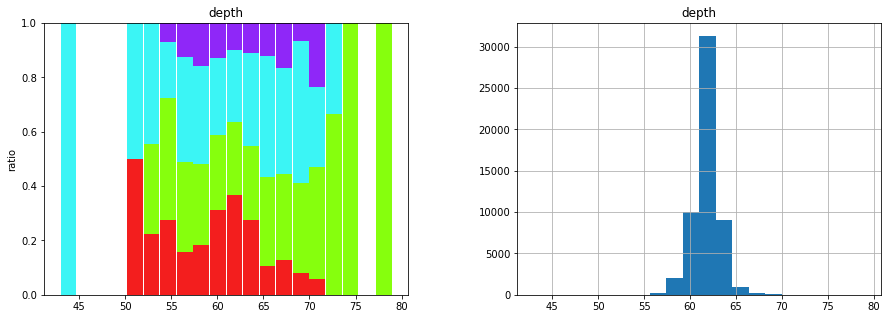

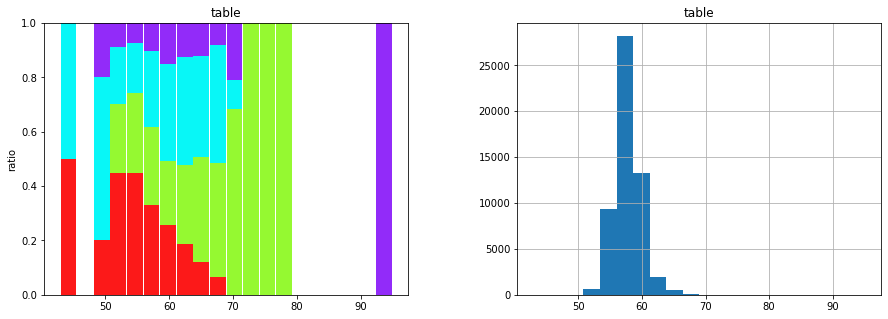

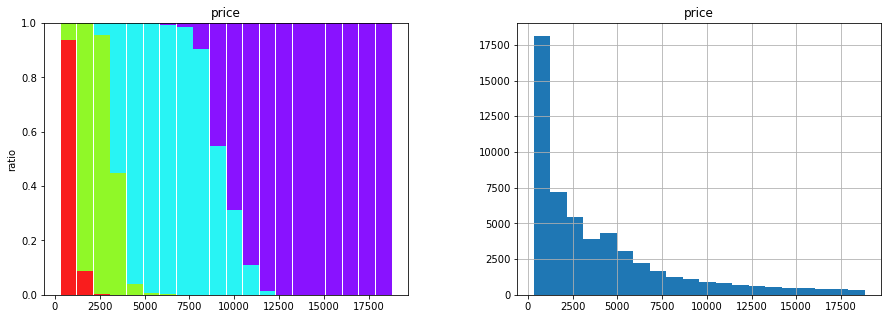

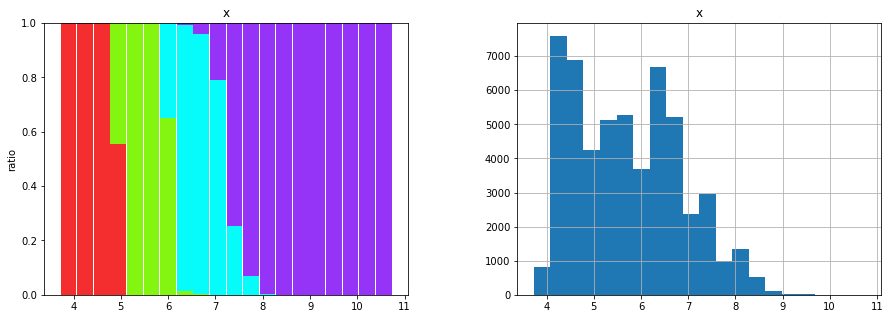

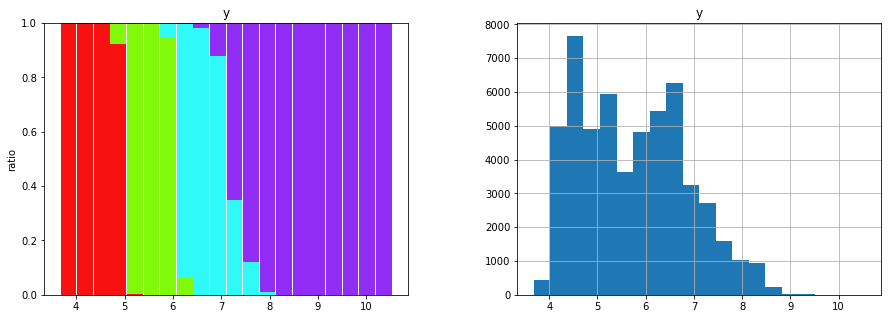

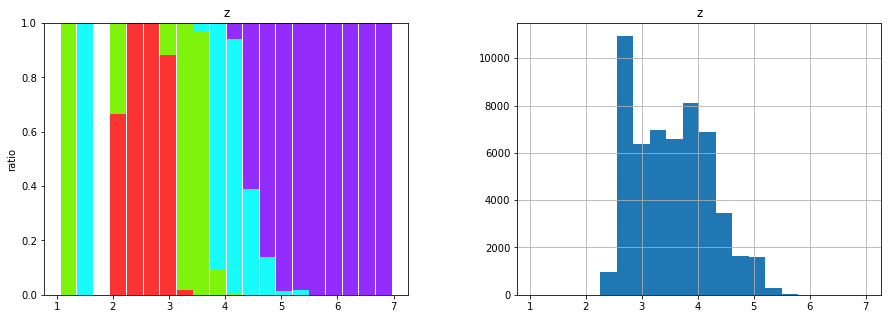

In [67]:
import colorsys
def stackedCont(metric, clusters, ax=None, title=None, n_bins=None):
    '''
    Inputs:
        metric: np array or pd series # ex: df['p2pRatio'] or np.array(df['p2pRatio'])
        clusters: np array or pd series or list # Labels attributed to elementts of metric (same indexation)
    Output:
        plots stacked histogram normalized to 1
    '''
    unique_c = np.unique(clusters)
    plot = False
    if ax==None:
        fig, ax = plt.subplots(figsize=(8,5))
        plot=True
    data = []
    legend = []
    for c in unique_c:
        legend.append(str(c))
        idx = np.where(clusters==c)[0]
        data += [metric[idx]]
    # ax.hist(data,stacked=True, normed=True, label=legend)
    n, bins, patches = ax.hist(data,stacked=True, bins=n_bins)
    nn = [np.divide(a, n[-1]) for a in n[:-1]]
    nn += [np.subtract(np.ones(nn[0].shape), nn[-1])]
    ax.clear()
    colors =_get_colors(unique_c.size)
    width = (bins[1]-bins[0])*0.95
    ax.bar(bins[:-1], nn[0], color=colors[0], align='edge', width=width, label=0)
    for i in range(1,len(nn)):
        ax.bar(bins[:-1], nn[i], color=colors[i], bottom=nn[i-1], width=width, align='edge', label=i)
    ax.set_ylim(ymin=0, ymax=1)
    ax.set_title(title)
    ax.set_ylabel('ratio')
    if plot:
        plt.legend()
        plt.show()
    else:
        return ax
    
n_bins=20
fig, ax1 = plt.subplots(figsize=(15,5))
def _get_colors(num_colors):
    '''
    Inputs:
        num_colors: int
    Output:
        colots: list of colors usable by pyplot
    generates num_colors distinct colors for matplotlib
    Alert: Exists in 2 files: clustering.py and stacked_histograms.py
    '''
    colors=[]
    for i in np.arange(0., 360., 360. / num_colors):
        hue = i/360.
        lightness = (50 + np.random.rand() * 10)/100.
        saturation = (90 + np.random.rand() * 10)/100.
        colors.append(colorsys.hls_to_rgb(hue, lightness, saturation))
    return colors
def cluster_sizes(labels, give_back=False, title='cluster_sizes', ax=None):
    '''
    Inputs:
        labels: 1D np array of labels.
        give_back: bool, if True, return the cluster sizes ordered
    Output:
        Plot bar chart of cluster sizes
        if give_back, return list of int
    '''
    clusters, cluster_sizes = np.unique(labels, return_counts=True)
    plot=False
    if ax==None:
        plot=True
        fig, ax = plt.subplots()
    
    ax.set_title(title)
    ax.set_ylabel('count')
    ax.set_xlabel('clusters')
    ax.bar(clusters, cluster_sizes)
    if plot:
        plt.show()
    if give_back:
        Sizes = {}
        for c, cs in zip(clusters, cluster_sizes):
            Sizes[c]=cs
        return Sizes
    
    
cluster_sizes(labels, title='KMeans, K='+str(K), ax=ax1)
plt.show()
for cont in data.select_dtypes(include=[np.number]).columns :
    fig, (ax1, ax2) = plt.subplots(1,2,figsize=(15,5))
    stackedCont(data[cont], labels, ax=ax1, title=cont, n_bins=n_bins)
    data.hist(cont, ax=ax2, bins=n_bins)
    plt.show()

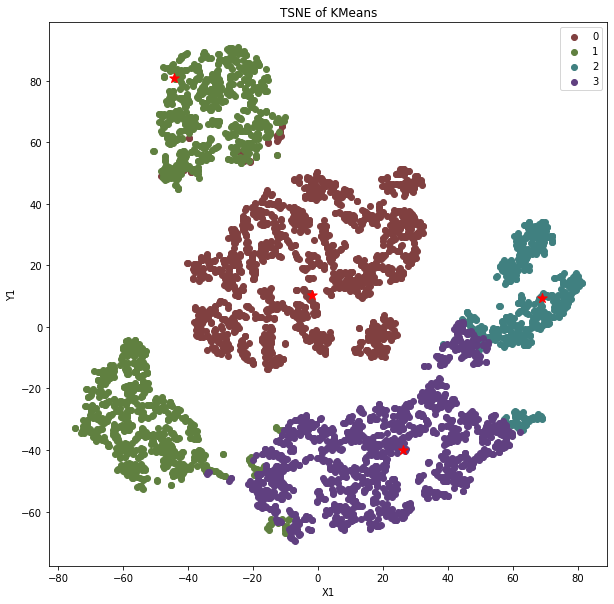

In [68]:
from sklearn.manifold import MDS, TSNE
import time
def scatter2D_labeled(X, Y, X_name, Y_name, labels, show_labels=None, title=None, legend=True, timeIt=False, alpha=0.1, clusterCenters=None, xC=None, yC=None, ymin=None, ymax=None, xmin=None, xmax=None, ax=None, some_text=None): 
    '''
    Inputs:
        X: 2D np array, shape (n,1), x coordinates
        Y: 2D np array, shape (n,1), y coordinates
        X_name: str, xlabel
        Y_name: str, ylabel
        labels: 2D np array, labels of data points
        show_labels: list of int, labels to show
        title: str, title
        legend: bool, show or don't show
        timeIt: bool, print elapsed time or not
        alpha: transparancy scatter plot
        clusterCenters: np arrays, result of clf.cluster_centers_ (not truncated on axis X and Y)
        xC: index of x of clusterCenters 
        yC: index of y of clusterCenters
        ymin, ymax, xmin, xmax: limits of the plot
        some_text: str, add text, example: score of clustering..
    Outputs:
        None, only a plot.
    Description:
        Plots in a 2D space, where x and y are both features.
        The datapoints are colored according to a label.
    '''
    start = time.time()
    # colors = # generate as many colors as labels.
    N = len(set(labels))
    HSV_tuples = [(x*1.0/N, 0.5, 0.5) for x in range(N)]
    colors = map(lambda x: colorsys.hsv_to_rgb(*x), HSV_tuples)
    
    if type(X) == list or type(Y) == list or type(labels) == list:
        print("X, Y and labels must be numpy arrays !!")
        return None
        
    plot=False
    if ax is None:
        fig, ax = plt.subplots(figsize=(10,10))
        plot=True
    ax.set_xlabel(X_name)
    ax.set_ylabel(Y_name)
    if ymin != None or ymax !=None:
        if ymin==None:
            ax.set_ylim(ymax=ymax)
        elif ymax == None:
            ax.set_ylim(ymin=ymin)
        else:
            ax.set_ylim(ymin=ymin, ymax=ymax)
            
    if xmin != None or xmax !=None:
        if xmin==None:
            ax.set_xlim(xmax=xmax)
        elif xmax == None:
            ax.set_xlim(xmin=xmin)
        else:
            ax.set_xlim(xmin=xmin, xmax=xmax)
            
    if title!=None:
        ax.set_title(title)
    
    if show_labels == None:
        for color, label in zip(colors, np.unique(labels)):
            ax.scatter(X[labels == label], Y[labels == label], color=color, alpha=alpha, label=label)
    else:
        for color, label in zip(colors, np.unique(labels)):
            if label in show_labels:
                ax.scatter(X[labels == label], Y[labels == label], color=color, alpha=alpha, label=label)
        clusterCenters = clusterCenters[show_labels, :]
                
    if legend:
        ax.legend()
    if some_text!=None:
        ax.text(0.1, 0.9, some_text, size=15, horizontalalignment='right')
    if type(clusterCenters) != type(None):
        x_centers = clusterCenters[:,xC]
        y_centers = clusterCenters[:,yC]
        ax.scatter(x_centers, y_centers, marker="*", s=400, c='r')
    if plot:
        plt.show()
    else:
        return ax
    if timeIt:
        print(time.time() - start)
def tsne(X, clf, sample_size=0.2):
    '''
    Inputs:
        X: 2D np array, scaled
        clf: clustering algorithm fit on X
        sample_size: float 0 to 1; fraction of X
    Output:
    plots t-sne with labels from clusters
    '''
    idx = np.random.randint(X.shape[0], size=int(sample_size*X.shape[0]))
    if idx.size > 10000:
        print('Careful, t-sne is expensive')
    X_sampled = X[idx, :]
    X_sampled = np.concatenate((X_sampled, clf.cluster_centers_), axis=0)
    labels = clf.labels_[idx]
    embedding = TSNE(n_components=2)
    X_mds = embedding.fit_transform(X_sampled)
    X_mds.shape
    n_clusters = len(clf.cluster_centers_)
    fig, ax = plt.subplots(figsize=(10,10))
    scatter2D_labeled(X_mds[:-n_clusters,0], X_mds[:-n_clusters,1], 'X1', 'Y1', labels, show_labels=None, title='TSNE of KMeans', legend=True, timeIt=False, alpha=1, clusterCenters=None, xC=None, yC=None, ymin=None, ymax=None, xmin=None, xmax=None, ax=ax)
    ax.scatter(X_mds[[-i for i in range(1,n_clusters+1)], 0], X_mds[[-i for i in range(1,n_clusters+1)], 1], marker='*', color='r', s=100)
    plt.show()
tsne(X, algo, sample_size=0.1)

# Supervised methods

## Feature ingeneering

We've seen that $(x,y,z)$ and carat were strongly correlated to $PC0$ and all together. We'll now performe pca for these 4 variables only and reduce them to one PC. 

In [69]:
# applying log to data
Z = data[["x","y","z","carat"]].applymap(log)

## Scale data
X_scaler = StandardScaler()
X_scaler.fit(Z)
Z = X_scaler.transform(Z)
pca = PCA(n_components=1)
pca.fit(Z)

Z = pca.transform(Z).flatten()

print("Variance explained by the first PC:",
     sum(pca.explained_variance_ratio_))

print( "\nLinear correlation Of PC with price:",
      np.corrcoef(np.asarray(data[['price']].applymap(log)).flatten(), Z)[0,1])


#from sklearn.metrics import mutual_info_score

# def shan_entropy(c):
#     c_normalized = c / float(np.sum(c))
#     c_normalized = c_normalized[np.nonzero(c_normalized)]
#     H = -sum(c_normalized* np.log(c_normalized))  
#     return H

# def I(x, y, bins):
#     c_xy = np.histogram2d(x, y, bins)[0]
#     I = mutual_info_score(None, None, contingency=c_xy)
#     return I

# I(np.asarray(data[['price']].applymap(log)).flatten(),Z, 10000), shan_entropy(np.asarray(data[['price']]).flatten())

Variance explained by the first PC: 0.9965515096663691

Linear correlation Of PC with price: 0.9665606443500036


In [70]:
cos2 = Z**2/np.sum(Z**2)
px.scatter( x=cos2, y= data["price"],
          labels={"x":"Cos2", "y":"Price"})

Cette nouvelle variable represente bien assez de données de prix variés, nous allons remplacer $(x,y,z)$ et carat par celle-ci

## Regression

In [71]:
### X as PC and cat_cols one_hot encoded
X = np.array(pd.concat( [pd.Series(Z),
                        pd.get_dummies(data[cat_col]).reset_index()
                       ],
                      axis=1
                     )
           )

# ### X as PC and cat_cols ordinal_encoded
# from sklearn.preprocessing import OrdinalEncoder

# W = data[cat_col]
# oe = OrdinalEncoder()
# oe.fit(W)
# W = oe.transform(W)
# X= np.hstack((Z.reshape(-1,1), W))

Y = np.array(data[['price']]\
             .applymap(log)
            ).flatten()

##### X as PC only
# X = Z.reshape(-1,1)

##### Standard scaling of Y
# Y_scaler = StandardScaler()
# Y_scaler.fit(Y.reshape(-1,1))
# Y = Y_scaler.transform(Y.reshape(-1,1))

In [72]:
from sklearn.model_selection import train_test_split

#### Spliting and scaling data

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=True)

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

# Data standardization
X_train /= X_train.max()
X_test /= X_test.max()

print('X_train shape:', X_train.shape)
print('X_test shape:', X_test.shape)


print('y_train shape:', Y_train.shape)
print('y_test shape:', Y_test.shape)


print(X_train.shape[0], 'train samples')
print(X_test.shape[0], 'test samples')

X_train shape: (43133, 22)
X_test shape: (10784, 22)
y_train shape: (43133,)
y_test shape: (10784,)
43133 train samples
10784 test samples


Y_test minmax diffrence: 18471.000000000007
Y_test iqr: 4354.5
Y_test mean 3977.436387240356
Y_test average absolute difference to mean: 3067.50535109713
Y_test std 4048.878365839289

Rsquare:  0.9626069750019985

MAE_test: 401.94444055302563
NMAE_minmax_test: 0.021760838100429076
NMAE_iqr_test: 0.09230553233506157
NMAE_mean_test: 0.1010561581430859
NMAE_avgdist_test: 0.1310330038737391
NMAE_std_test: 0.09927303421714594

RMSE_test 782.9427917092062
NRMSE_std_test 0.19337276177890578
NRMSE_iqr_test 0.17980084779175706
NRMSE_mean_test: 0.19684608765105388

MAE_train: 0.10507137561222403
MSE_train: 0.018289723563235
RMSE_train 0.13523950444760954


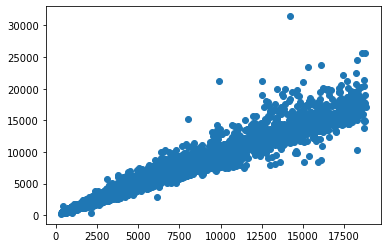

In [73]:
from sklearn.linear_model import LinearRegression
from sklearn import metrics

def model_run(model, X_train, Y_train, X_test, Y_test):
    reg = model
    reg.fit(X_train,Y_train)
    y_pred = np.exp(reg.predict(X_test))
    y_pred_train = reg.predict(X_train)
    
    Y_test = np.exp(Y_test)
    
    plt.scatter(Y_test,y_pred)
    
    #### metrics
    MAE = metrics.mean_absolute_error(Y_test, y_pred)
    RMSE = np.sqrt(metrics.mean_squared_error(Y_test, y_pred))
    
    #### metrics normalizations
    iqr = np.subtract(*np.percentile(Y_test, [75, 25], interpolation="midpoint"))
    minmax_diff = np.max(Y_test) - np.min(Y_test)
    mean_price = np.average(Y_test)
    mean_abs_diff = np.average(np.abs(Y_test - np.average(Y_test)))
    std = np.std(Y_test)
    
    print("Y_test minmax diffrence:", minmax_diff)
    print("Y_test iqr:", iqr)
    print("Y_test mean", np.average(Y_test) )
    print("Y_test average absolute difference to mean:", mean_abs_diff)
    print("Y_test std", std )
    
    print("\nRsquare: ", metrics.r2_score(Y_test, y_pred))
    
    print('\nMAE_test:', MAE)
    print('NMAE_minmax_test:', 1/minmax_diff*MAE)
    print('NMAE_iqr_test:', 1/iqr*MAE)
    print('NMAE_mean_test:', 1/mean_price*MAE)
    print("NMAE_avgdist_test:", 1/mean_abs_diff*MAE)
    print("NMAE_std_test:", 1/std*MAE)

    print('\nRMSE_test', RMSE)
    print('NRMSE_std_test', 1/std*RMSE)
    print('NRMSE_iqr_test', 1/iqr*RMSE)
    print('NRMSE_mean_test:', 1/mean_price*RMSE)

    print('')

    print('MAE_train:', metrics.mean_absolute_error(Y_train, y_pred_train))
    print('MSE_train:', metrics.mean_squared_error(Y_train, y_pred_train))
    print('RMSE_train', np.sqrt(metrics.mean_squared_error(Y_train, y_pred_train)))
    
model_run(LinearRegression(), X_train, Y_train, X_test, Y_test)

Y_test minmax diffrence: 18471.000000000007
Y_test iqr: 4354.5
Y_test mean 3977.436387240356
Y_test average absolute difference to mean: 3067.50535109713
Y_test std 4048.878365839289

Rsquare:  0.9847052105205406

MAE_test: 56.45443320759077
NMAE_minmax_test: 0.003056382069600495
NMAE_iqr_test: 0.012964618947661216
NMAE_mean_test: 0.014193673439680138
NMAE_avgdist_test: 0.01840402110053342
NMAE_std_test: 0.013943227755099126

RMSE_test 500.73330915360475
NRMSE_std_test 0.12367210469406337
NRMSE_iqr_test 0.1149921481579067
NRMSE_mean_test: 0.12589348022257774

MAE_train: 0.01757324497363502
MSE_train: 0.009752294572461755
RMSE_train 0.09875370662644392


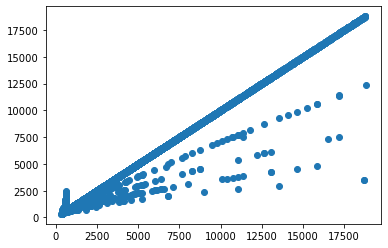

In [74]:
from sklearn.neighbors import KNeighborsRegressor

model = KNeighborsRegressor(n_neighbors = 8, metric = 'minkowski', p = 2)

model_run(model, X_train, Y_train, X_test, Y_test)

In [79]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

model = Sequential()
model.add(Dense(256, activation='relu', input_shape=(22,)))
model.add(Dense(256, activation='relu'))
model.add(Dense(256, activation='relu'))
model.add(Dense(256, activation='relu'))
model.add(Dense(1, activation='relu'))
model.summary()
model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error','mean_squared_error'])
history = model.fit(X_train,Y_train,batch_size=64,epochs=100,verbose=2)
test=model.evaluate(X_test, Y_test, verbose=1)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 256)               5888      
_________________________________________________________________
dense_11 (Dense)             (None, 256)               65792     
_________________________________________________________________
dense_12 (Dense)             (None, 256)               65792     
_________________________________________________________________
dense_13 (Dense)             (None, 256)               65792     
_________________________________________________________________
dense_14 (Dense)             (None, 1)                 257       
Total params: 203,521
Trainable params: 203,521
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
674/674 - 2s - loss: 0.7581 - mean_absolute_error: 0.7581 - mean_squared_error: 2.1657
Epoch 2/100
674

Epoch 73/100
674/674 - 2s - loss: 0.1003 - mean_absolute_error: 0.1003 - mean_squared_error: 0.0778
Epoch 74/100
674/674 - 2s - loss: 0.1199 - mean_absolute_error: 0.1199 - mean_squared_error: 0.1262
Epoch 75/100
674/674 - 2s - loss: 0.0859 - mean_absolute_error: 0.0859 - mean_squared_error: 0.0561
Epoch 76/100
674/674 - 2s - loss: 0.0881 - mean_absolute_error: 0.0881 - mean_squared_error: 0.0755
Epoch 77/100
674/674 - 2s - loss: 0.0786 - mean_absolute_error: 0.0786 - mean_squared_error: 0.0520
Epoch 78/100
674/674 - 2s - loss: 0.0959 - mean_absolute_error: 0.0959 - mean_squared_error: 0.0879
Epoch 79/100
674/674 - 2s - loss: 0.1058 - mean_absolute_error: 0.1058 - mean_squared_error: 0.1026
Epoch 80/100
674/674 - 2s - loss: 0.0883 - mean_absolute_error: 0.0883 - mean_squared_error: 0.0709
Epoch 81/100
674/674 - 2s - loss: 0.0982 - mean_absolute_error: 0.0982 - mean_squared_error: 0.0920
Epoch 82/100
674/674 - 2s - loss: 0.1262 - mean_absolute_error: 0.1262 - mean_squared_error: 0.1481


Y_test minmax diffrence: 18471.000000000007
Y_test iqr: 4354.5
Y_test mean 3977.436387240356
Y_test average absolute difference to mean: 3067.50535109713
Y_test std 4048.878365839289

Rsquare:  0.9998471213697842

MAE_test: 2.404024480712879
NMAE_minmax_test: 0.00013015129016906925
NMAE_iqr_test: 0.000552078190541481
NMAE_mean_test: 0.0006044155698944694
NMAE_avgdist_test: 0.0007837066950357725
NMAE_std_test: 0.0005937507288427892

RMSE_test 50.061991429676894
NRMSE_std_test 0.012364409820767629
NRMSE_iqr_test 0.011496610731353059
NRMSE_mean_test: 0.012586497068884902

MAE_train: 5.873142347318056e-16
MSE_train: 2.5383350343269476e-30
RMSE_train 1.5932153132351408e-15


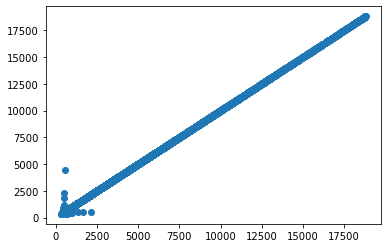

In [83]:
from sklearn.tree import DecisionTreeRegressor

model = DecisionTreeRegressor()

model_run(model, X_train, Y_train, X_test, Y_test)

Y_test minmax diffrence: 18471.000000000007
Y_test iqr: 4354.5
Y_test mean 3977.436387240356
Y_test average absolute difference to mean: 3067.50535109713
Y_test std 4048.878365839289

Rsquare:  0.9999347116425165

MAE_test: 2.9435278388397768
NMAE_minmax_test: 0.00015935941956795926
NMAE_iqr_test: 0.0006759737831759736
NMAE_mean_test: 0.0007400565470468955
NMAE_avgdist_test: 0.0009595836035907773
NMAE_std_test: 0.0007269983370393531

RMSE_test 32.715427638640584
NRMSE_std_test 0.008080121130499563
NRMSE_iqr_test 0.007513015877515348
NRMSE_mean_test: 0.008225254775561441

MAE_train: 0.0010910676892295264
MSE_train: 0.00017385865160578052
RMSE_train 0.013185547072676981


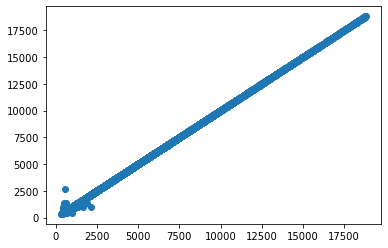

In [88]:
from sklearn.ensemble import RandomForestRegressor

model = RandomForestRegressor(n_estimators = 25)

model_run(model, X_train, Y_train, X_test, Y_test)

In [86]:
nb_estimators_list = range(1,45)
list_mae = []
list_rmse = []
list_mae_train = []
list_rmse_train = []
for i in nb_estimators_list:
    rf = RandomForestRegressor(n_estimators = i)
    rf.fit(X_train,Y_train)
    y_pred = rf.predict(X_test)
    list_mae.append(metrics.mean_absolute_error(np.exp(Y_test), np.exp(y_pred)))
    list_rmse.append(np.sqrt(metrics.mean_squared_error(np.exp(Y_test), np.exp(y_pred))))
    y_pred_train=rf.predict(X_train)
    list_mae_train.append(metrics.mean_absolute_error(np.exp(Y_train), np.exp(y_pred_train)))
    list_rmse_train.append(np.sqrt(metrics.mean_squared_error(np.exp(Y_train), np.exp(y_pred_train))))

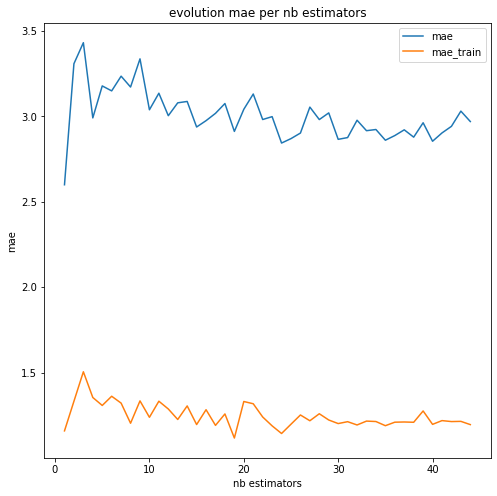

In [87]:
plt.figure(figsize=(8,8))
plt.title('evolution mae per nb estimators')
plt.plot(range(1,45), list_mae, label='mae', alpha=1)
plt.plot(range(1,45), list_mae_train, label='mae_train', alpha=1)
plt.xlabel('nb estimators')
plt.ylabel('mae')
plt.legend()

In [89]:
data = {'Algo':  ['Linear regression', 'KNeighborsRegressor', 'SVM', 'Random forest', 'Polynomial reg', 'decision tree', 'deep learning'],
        'MAE': ['782.942', '56.45443320759077', '337.460', '2.943', '351.064', '2.404', '332.473'],
        'RMSE' : ['793.099', '500.733', '643.845', '32.715', '706.579', '50.061', '668.357']
        }

df = pd.DataFrame (data)
df

,Algo,MAE,RMSE
0,Linear regression,782.942,793.099
1,KNeighborsRegressor,56.45443320759077,500.733
2,SVM,337.460,643.845
3,Random forest,2.943,32.715
4,Polynomial reg,351.064,706.579
5,decision tree,2.404,50.061
6,deep learning,332.473,668.357
